<a href="https://colab.research.google.com/github/dori943/colab-test/blob/main/Image_Generation_from_prompt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -q transformers==4.49 diffusers==0.32.2 accelerate safetensors

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.0/44.0 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.0/10.0 MB 149.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 117.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 96.1 MB/s eta 0:00:00


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

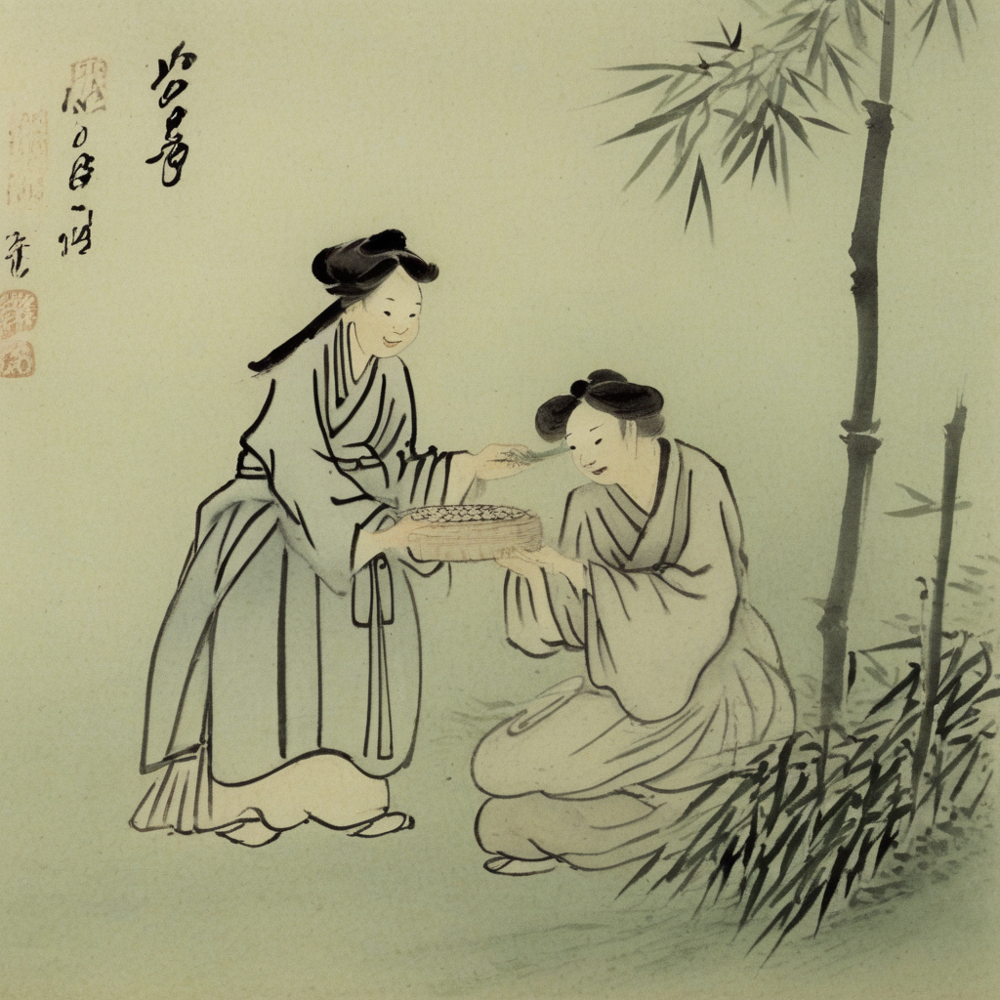

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline
from google.colab import drive
from IPython.display import display
import os

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/journal_maingirl2/output/journal_maingirl2-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "sub-oldwoman in a worn hanbok gently offers a small rice cake to the main-girl wearing an old hanbokCenter. A bamboo grove rustles softly in the breeze. Back right. Kimhongdo style, ink wash painting, muted earthy tones, subtle color highlights, thin line." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "text, bright colors, saturated tones,  golden embroidery, digital art, anime, cartoon, 3D render, fantasy, glossy finish, distorted face, blurry face, extra limbs" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/1014_con_3.png")

Mounted at /content/drive


Keyword arguments {'dtype': torch.float16} are not expected by StableDiffusionXLPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

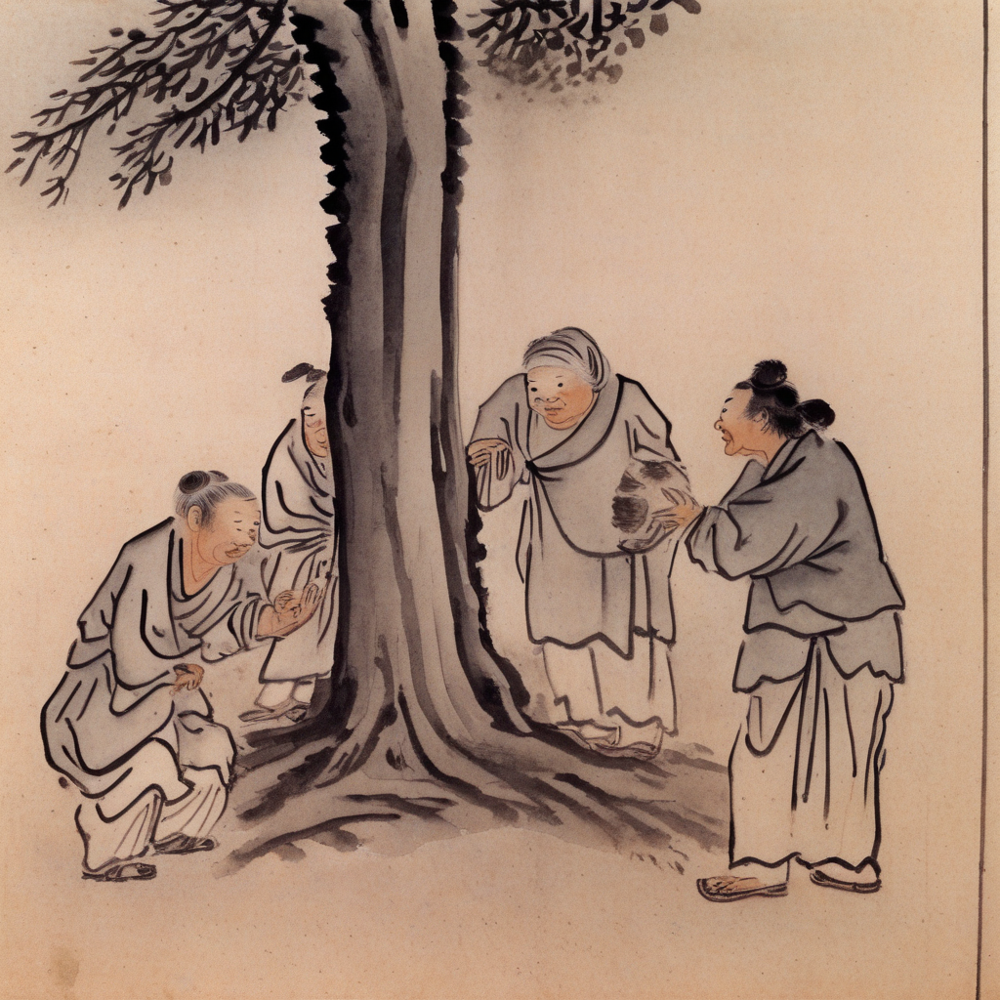

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
# [수정됨] --upgrade 플래그를 추가하여 라이브러리를 최신 버전으로 설치합니다.
!pip install -q --upgrade diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive', force_remount=True) # 재연동을 위해 force_remount=True 추가

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/journal_maingirl2/output/journal_maingirl2-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    dtype=torch.float16, # [수정됨] 'torch_dtype' 대신 'dtype'을 사용합니다.
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "An old woman desperately knocks ancient tree trunk with her hand. Center. another Four villagers observing with concerned faces. Right. kimhongdo style, ink wash painting, muted earthy tones, thin line" #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "text, bright colors, saturated tones,  golden embroidery, digital art, anime, cartoon, 3D render, fantasy, glossy finish, distorted face, blurry face, extra limbs" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
from IPython.display import display
display(image)

# 구글 드라이브에 이미지 저장
import os
save_path = "/content/drive/MyDrive/generated"
os.makedirs(save_path, exist_ok=True) # 폴더가 없으면 생성
image.save(os.path.join(save_path, "1014_intro.png"))

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

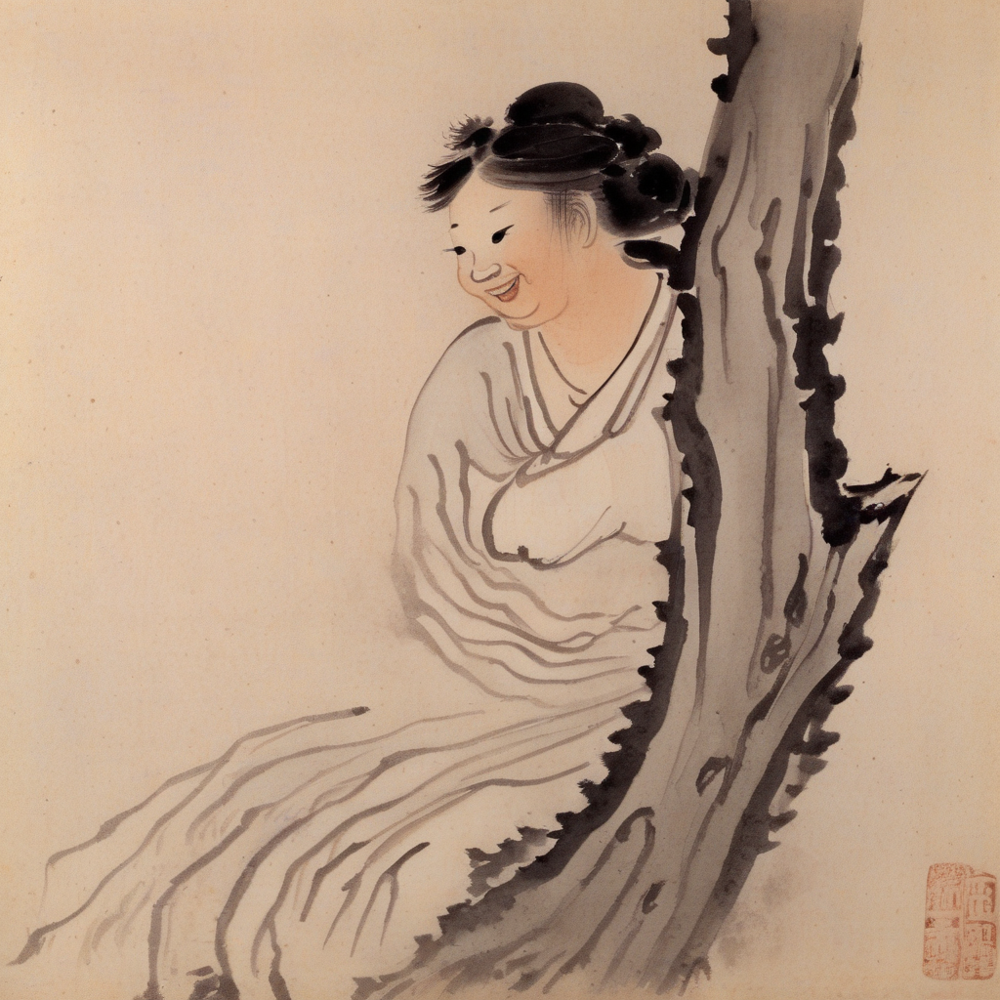

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/journal_maingirl2/output/journal_maingirl2-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "A joyful woman emerges from the dramatically split tree trunk, smiling radiantly. Center. tearful woman lovingly embraces her. Center left. kimhongdo style, ink wash painting, muted earthy tones, subtle color highlights, thin line" #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "text, bright colors, saturated tones,  golden embroidery, digital art, anime, cartoon, 3D render, fantasy, glossy finish, distorted face, blurry face, extra limbs" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/failcase2_2_khd.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

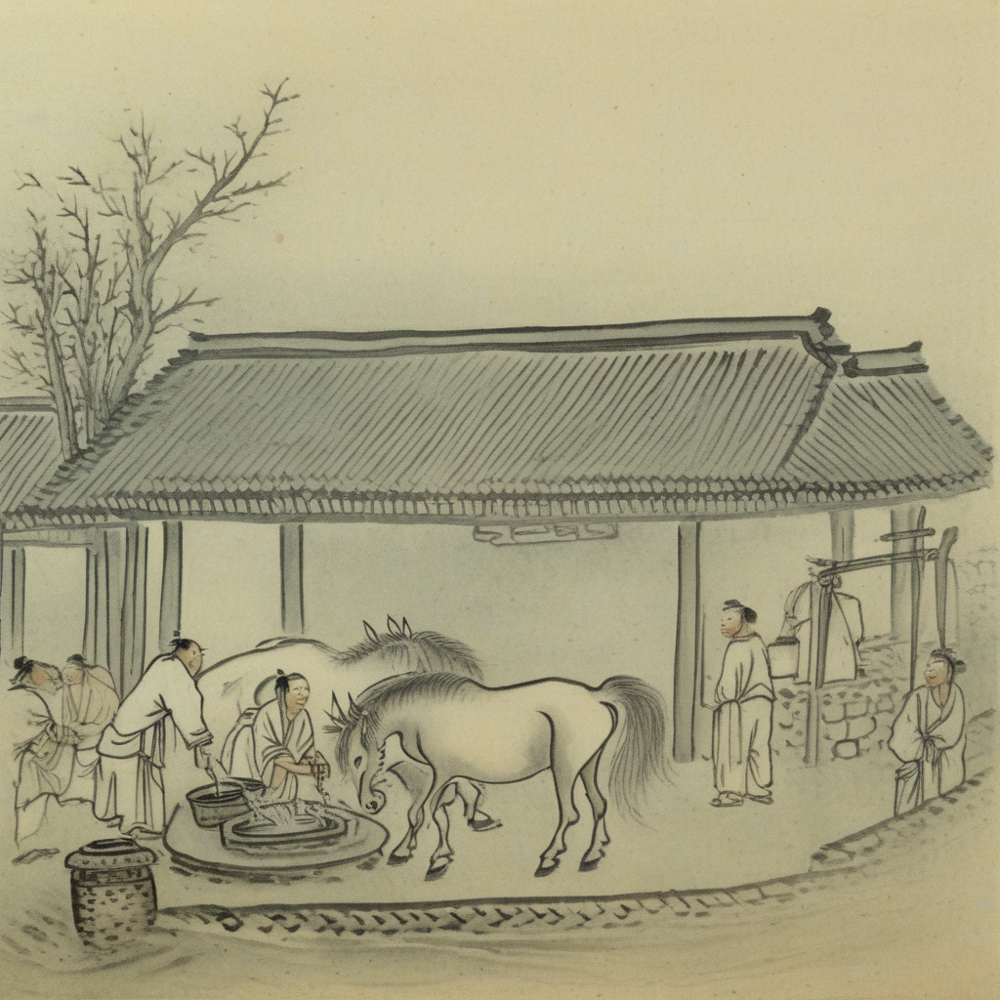

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/journal_maingirl2/output/journal_maingirl2-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "A majestic unicorn gracefully drinking water from a well in a bustling village marketplace, Kimhongdo style, ink wash painting, muted earthy tones, subtle color highlights, thin line." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "text, bright colors, saturated tones,  golden embroidery, digital art, anime, cartoon, 3D render, fantasy, glossy finish, distorted face, blurry face, extra limbs" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/failcase3_1_khd.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

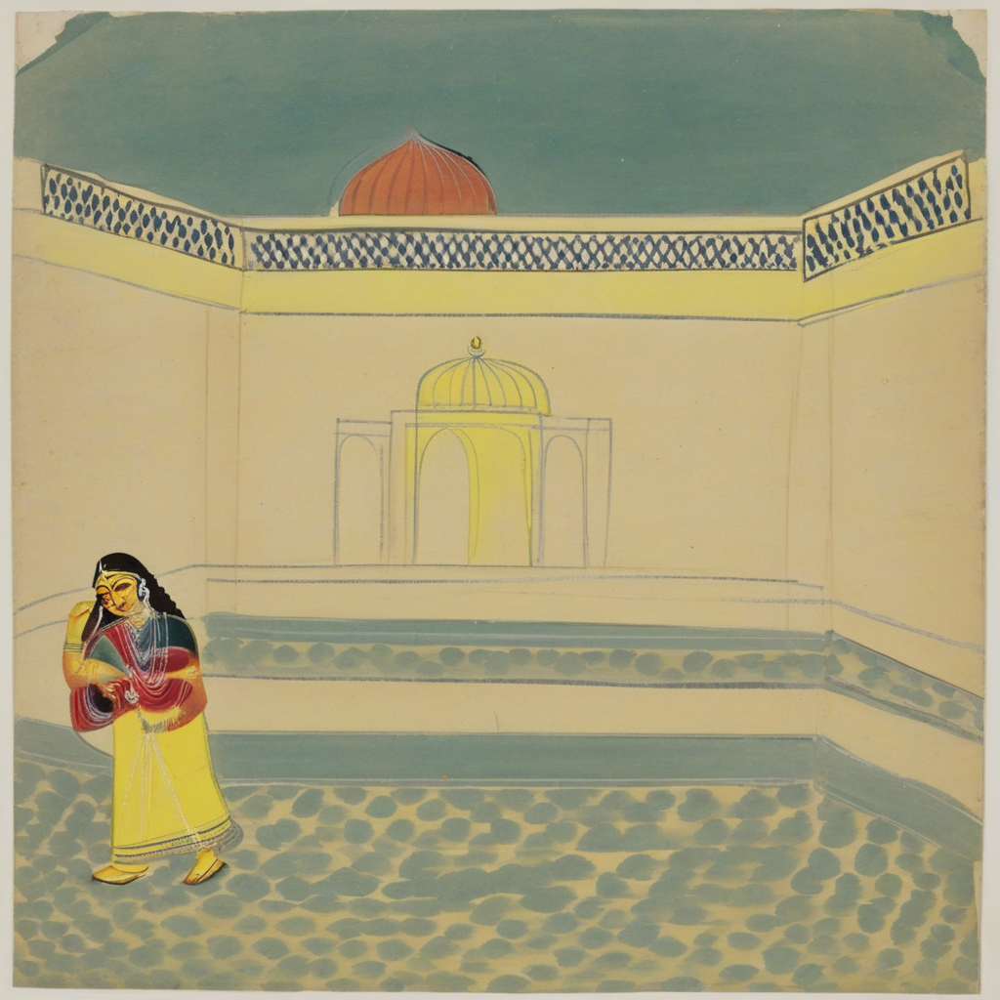

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "Main-girl in a simple jamdani sari sweeps the floor, serene yet weary. Center. A stone-paved path covered in dust leads to the main-man's palace. Back left. Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/failcase1_2_kalighat.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

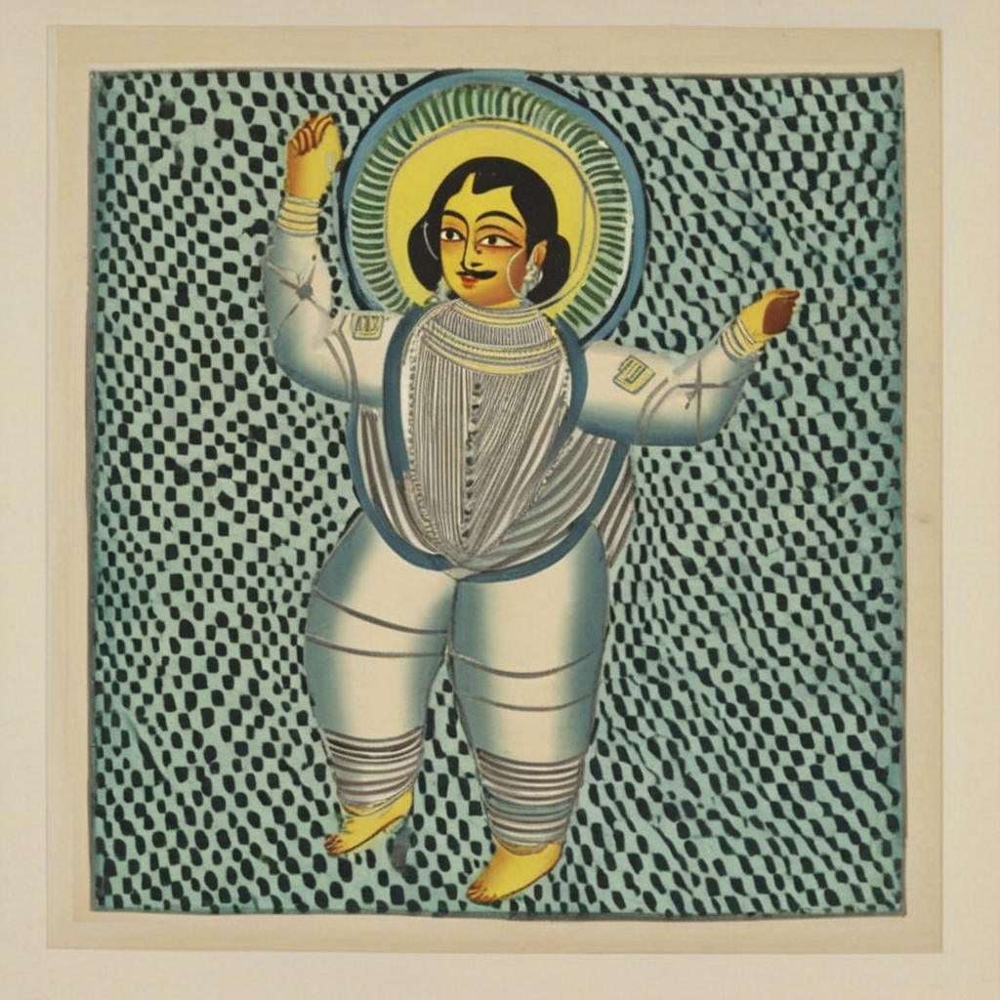

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "An astronaut in a full spacesuit floating gracefully against a backdrop of traditional Indian patterns and motifs, Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/failcase2_1_kalighat.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

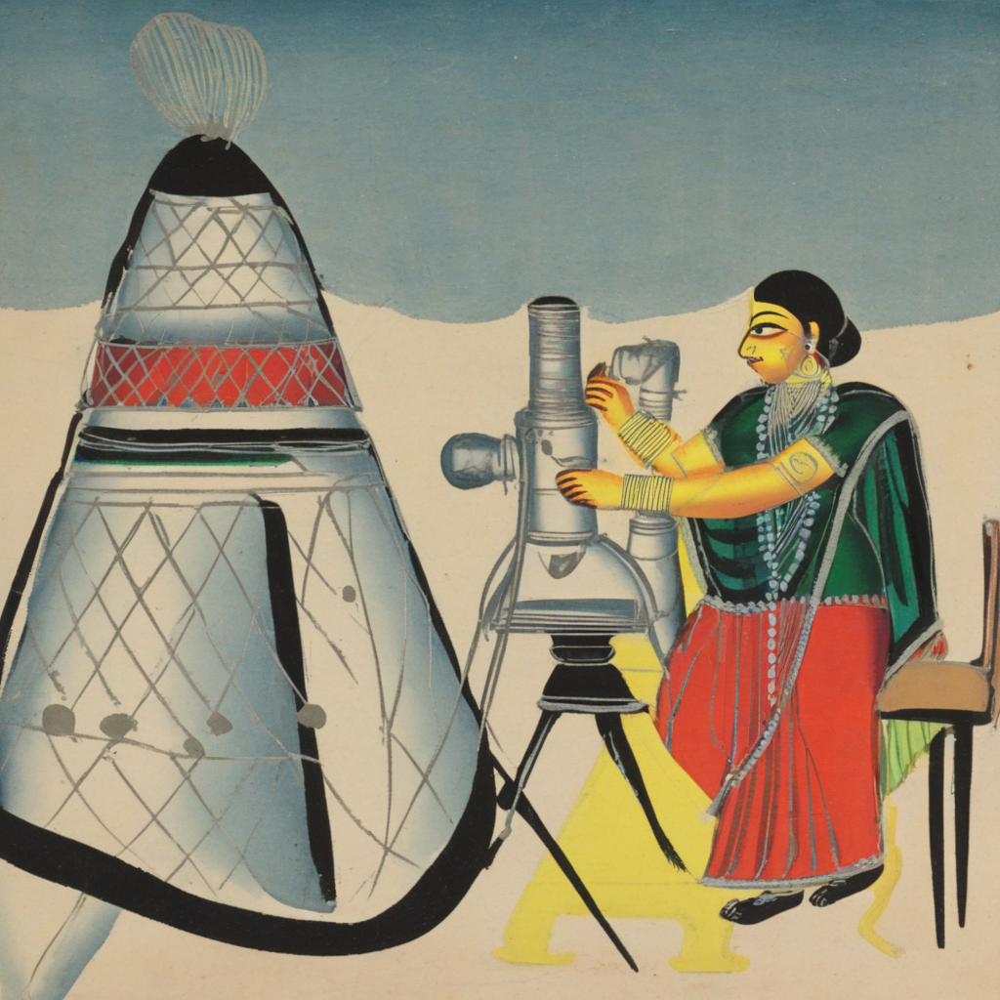

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "A scientist in traditional Indian attire looking through a powerful electron microscope in a laboratory, Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/failcase3_1_kalighat.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

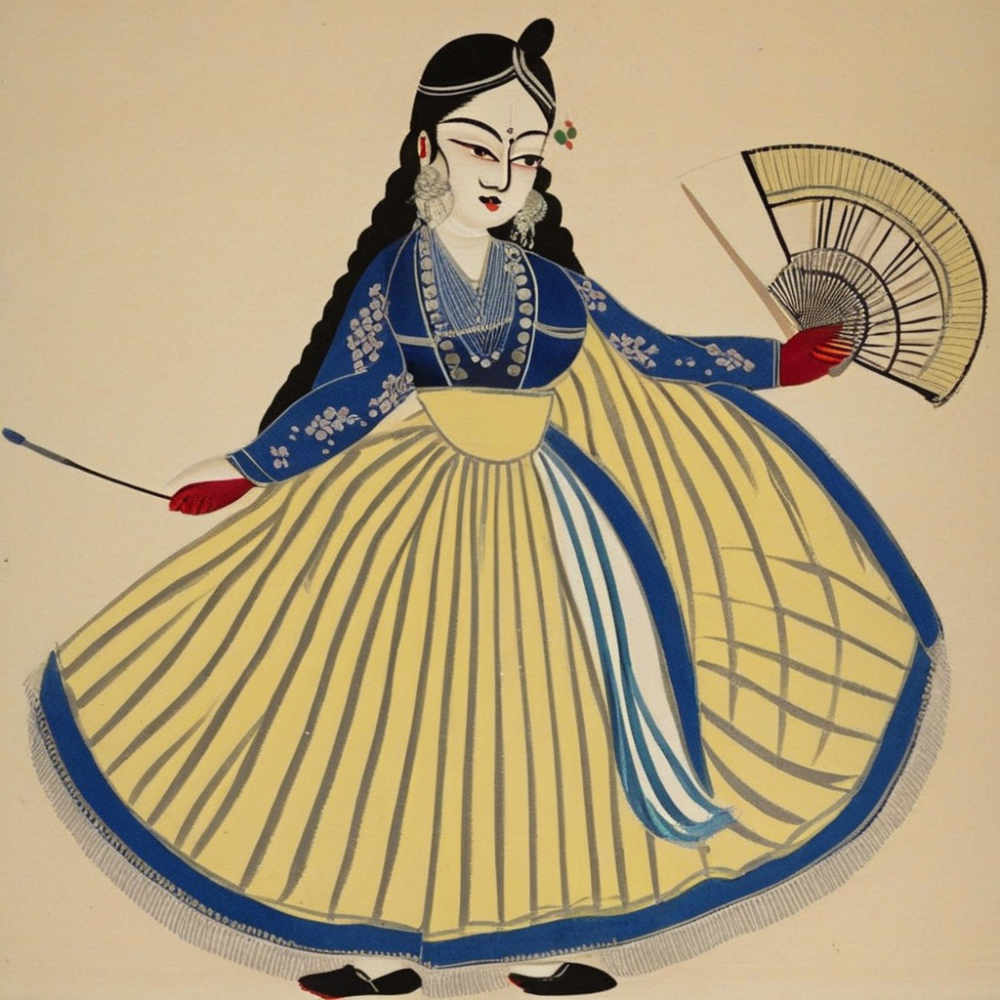

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "A graceful woman, wearing a beautifully embroidered hanbok with a flowing skirt, holding a traditional Korean fan. Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/failcase4_1_kalighat.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

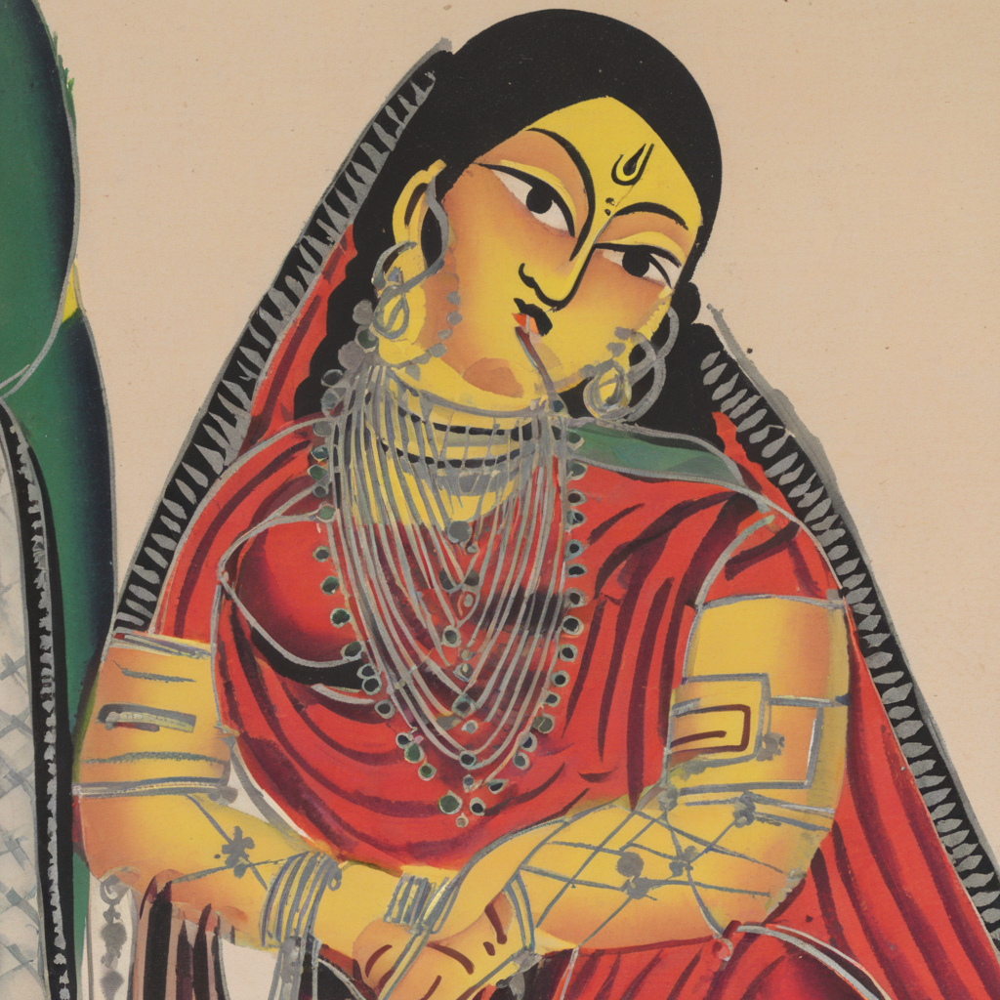

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "A woman in a traditional sari is looking down with a distinctly sad expression, a single tear tracing her cheek. Her posture is slumped in sorrow. Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/failcase5_kalighat.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

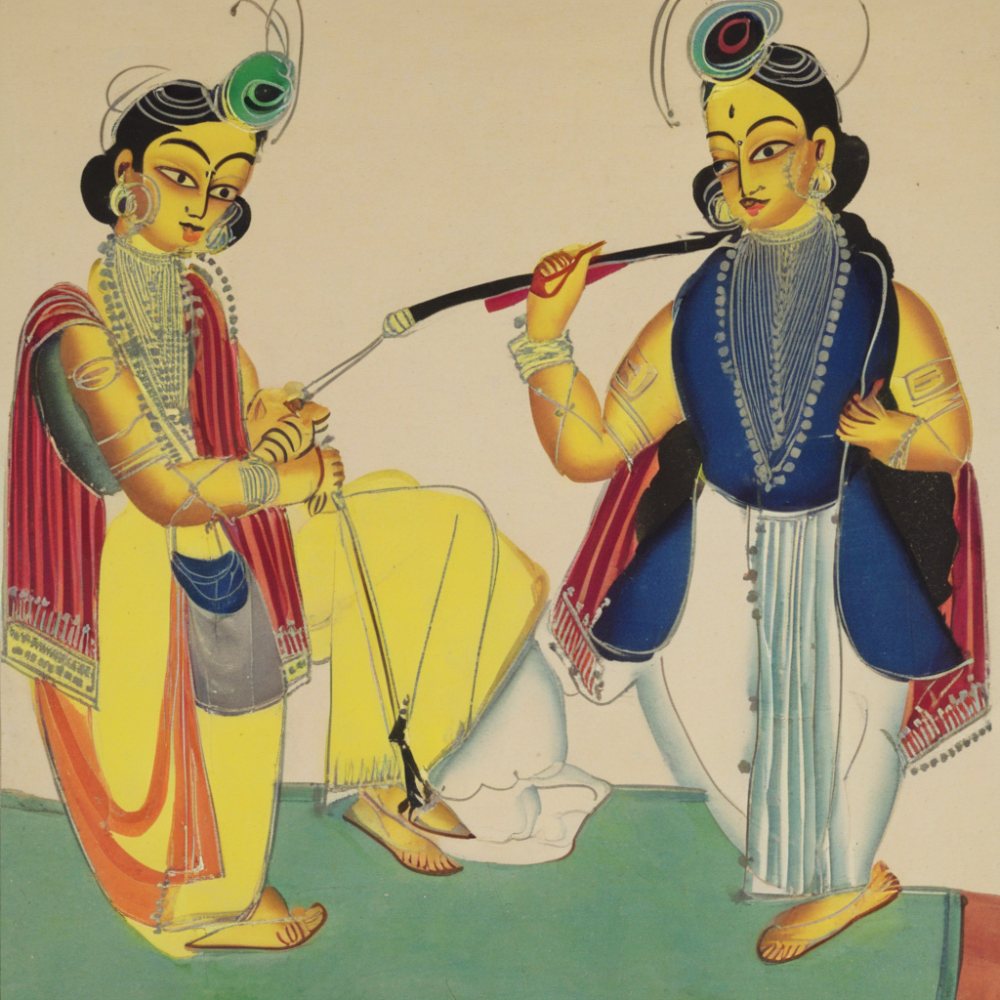

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "A wealthy babu in a fine dhoti sits proudly in the foreground, smoking a long hookah pipe.  Behind him to the left, a servant stands with a rigid posture, holding a small tray and waiting for a command. Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/failcase6_1_kalighat.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

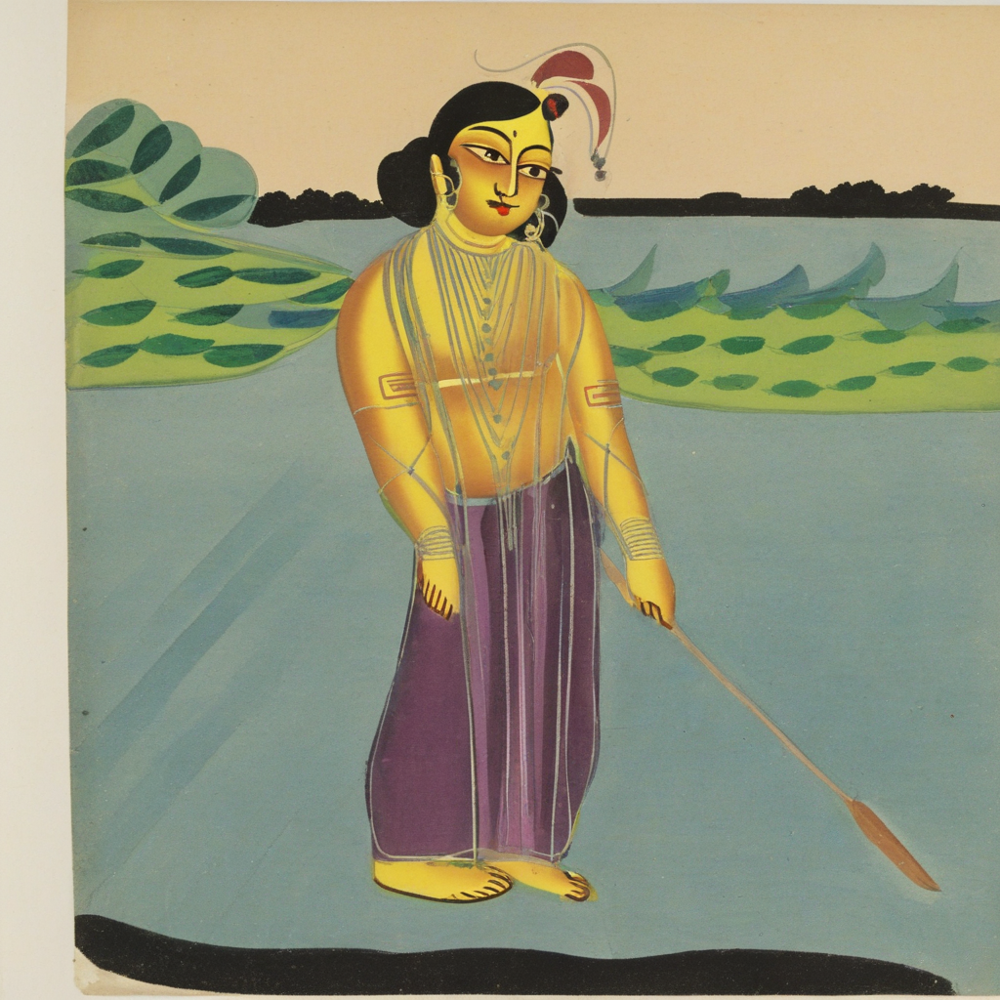

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "A scientist in traditional Indian attire looking through a powerful electron microscope in a laboratory, Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

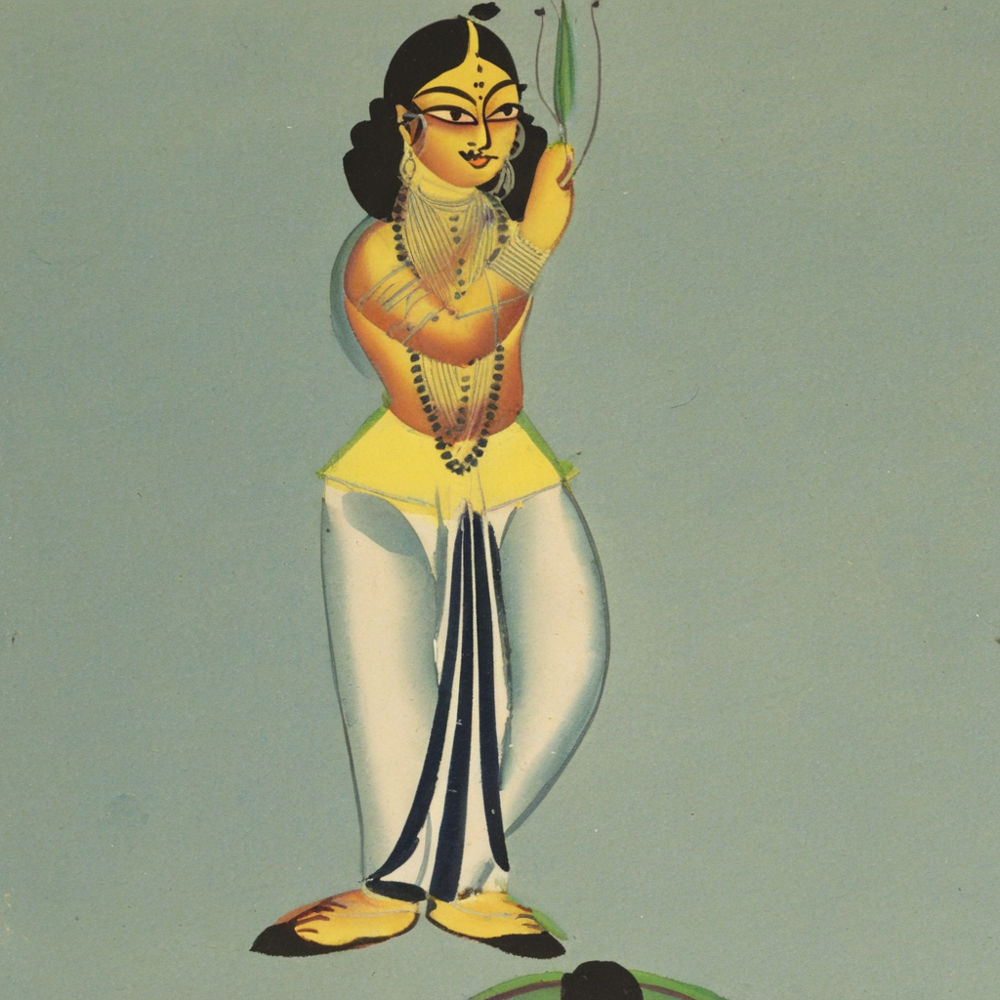

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "man in a simple dhoti with free-flowing hair and a confident stance aims a drawn bow skyward. Center. A vast stone stretches behind. Back center. Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/0911_kalighat_2_body_6.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

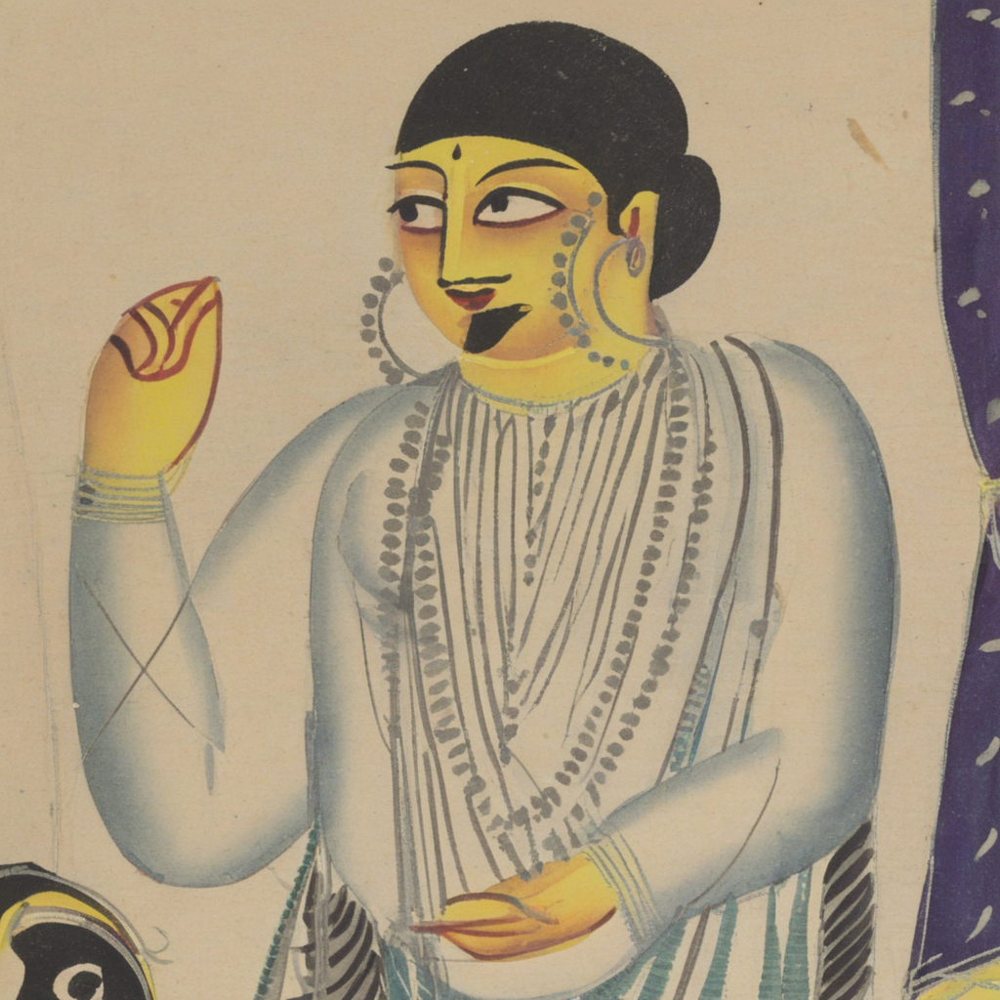

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "man in a simple dhoti stands confidently, adorned with delicate muslin, holding a golden ring. Center. Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/0911_kalighat_2_con_7.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

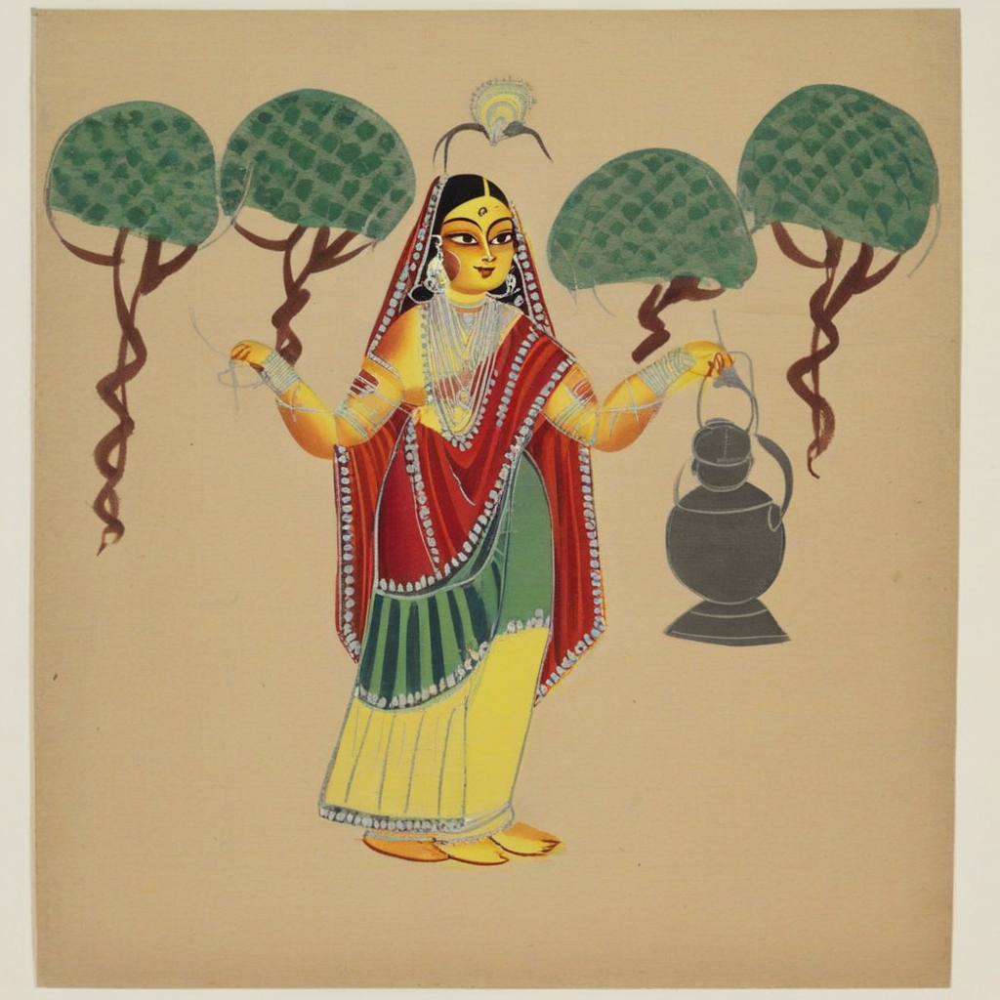

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "main-girl in a jamdani sari with braided hair tied with a red ribbon walks with a clay milk pot on her head. Center. A narrow dirt path winds forward. Back center. Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/0911_kalighat_3_intro_3.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

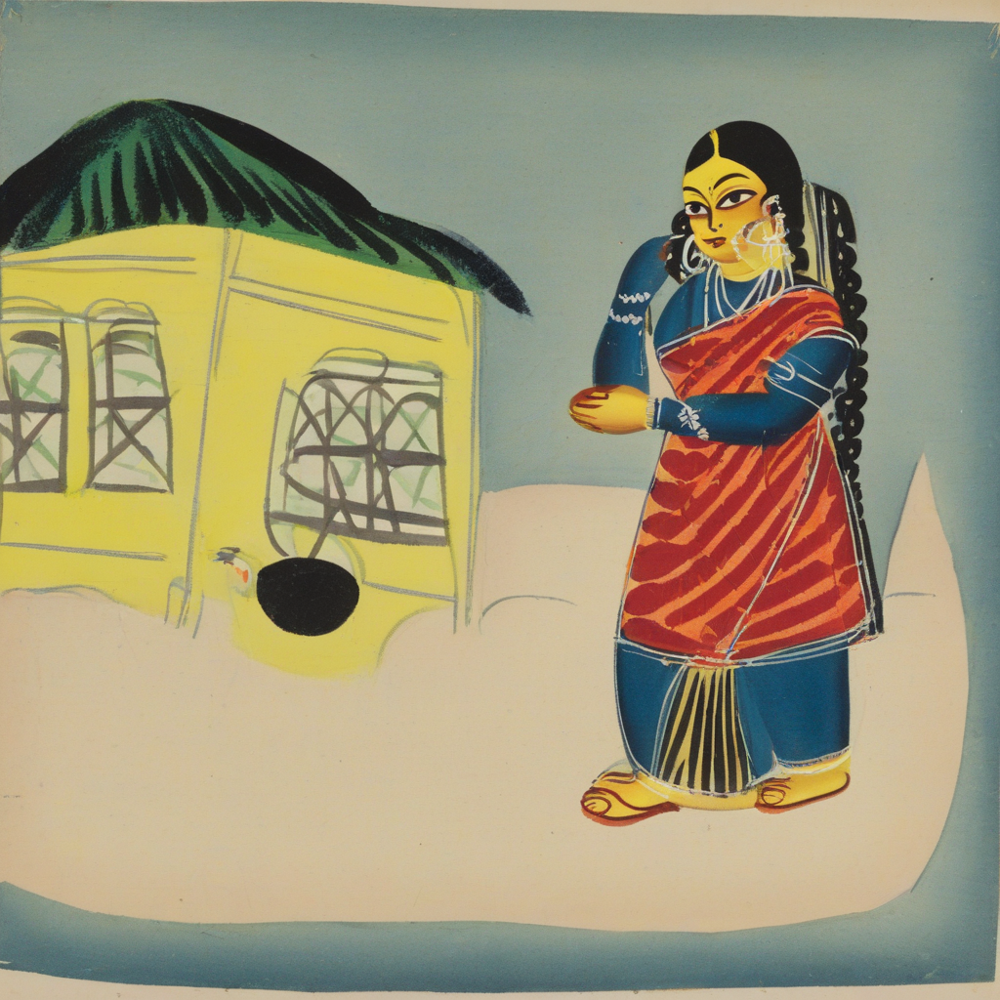

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "main-girl in a jamdani sari with braided hair tied with a red ribbon stands shocked, a fallen clay pot spilling milk beside her feet. Center. A simple clay hut stands in the distance. Back left. Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/0911_kalighat_3_body_2.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

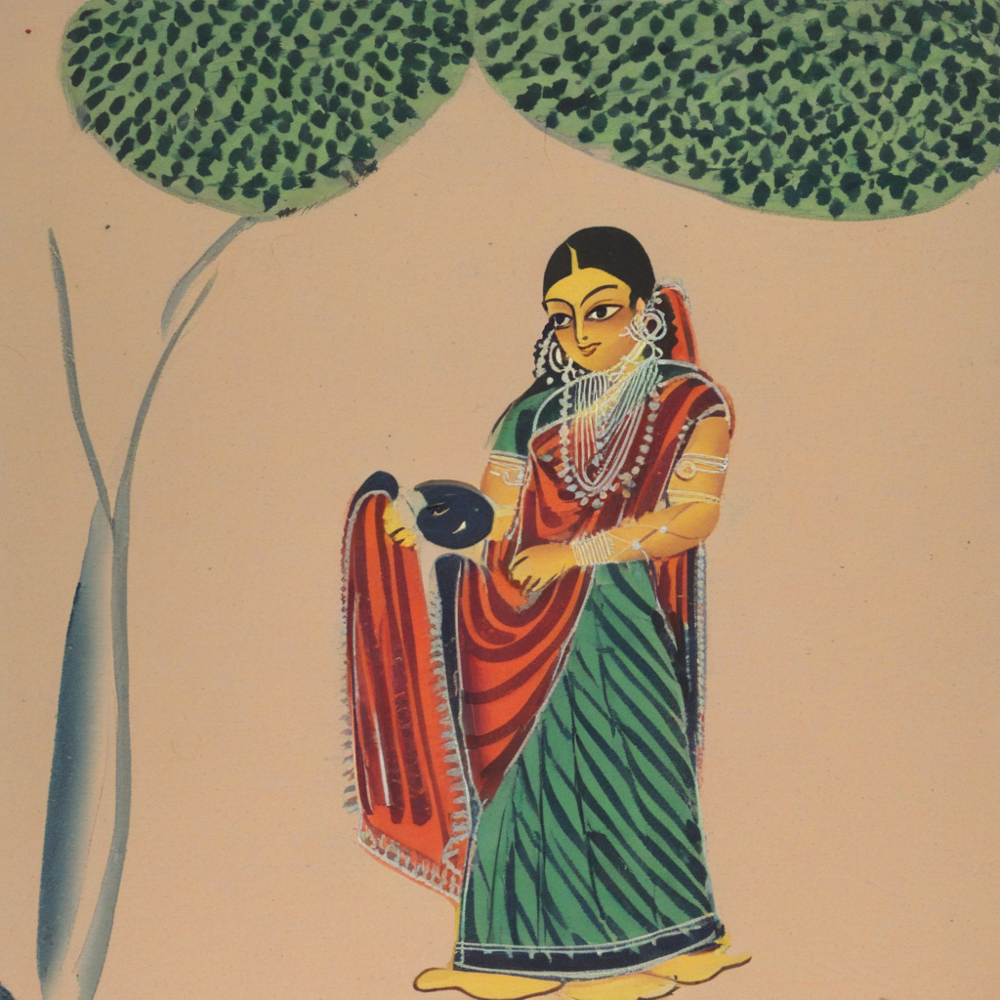

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat500_cropped_mainwoman/output/Kalighat500_cropped_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "main-girl in a jamdani sari with braided hair tied with a red ribbon stands with a somber expression. Center. A clay hut with ivy-covered walls. Back left. Kalighat Painting, Indian Folk Art, Bold Outlines." #@param {type:"string"}
#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "photorealistic, realistic, 3d, blurry, deformed, disfigured, poor anatomy, bad hands, extra limbs, watermark, text, signature, modern, digital painting" #@param {type:"string"}

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/0911_kalighat_3_con_1.png")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

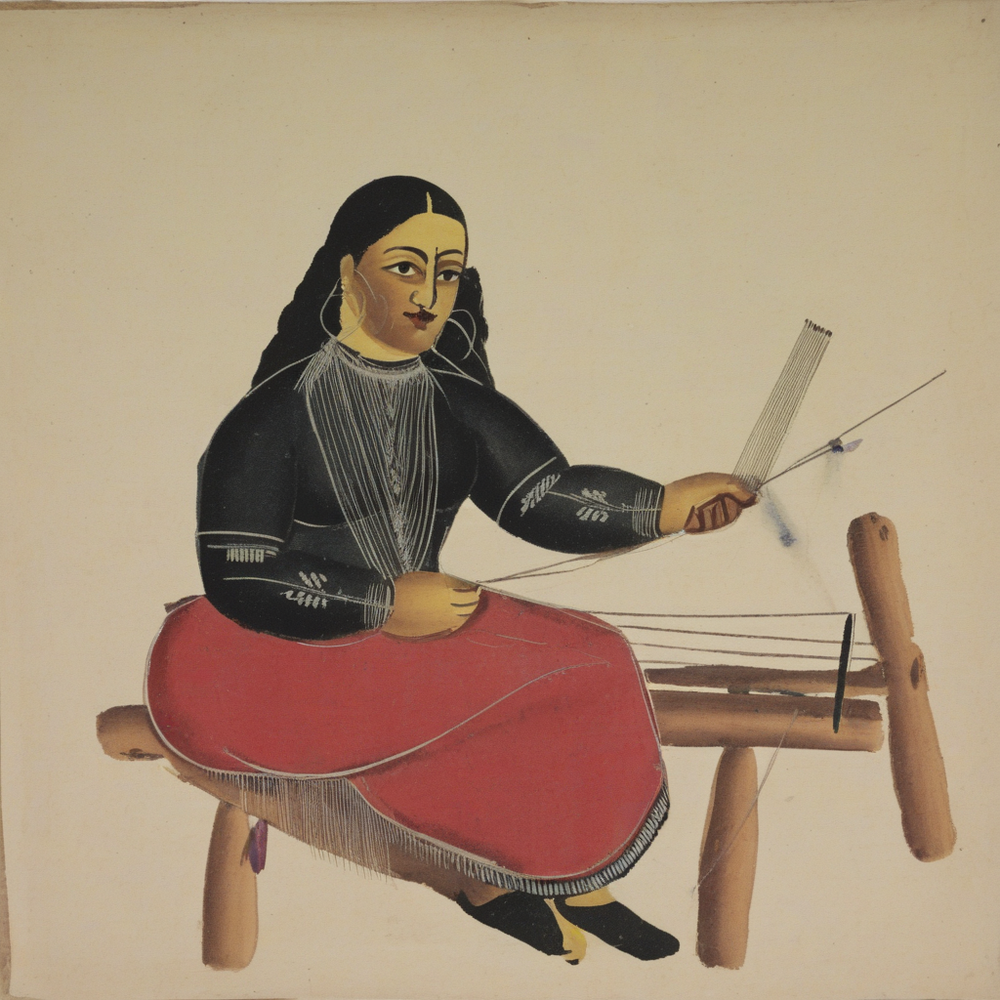

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat300/output/Kalighat300-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "woman with long black hair, wearing red blouse, gold earrings and necklace, weaving on a traditional loom, surrounded by colorful threads."

#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "text, bright colors, saturated tones,  golden embroidery, digital art, anime, cartoon, 3D render, fantasy, glossy finish, distorted face, blurry face, extra limbs"

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/Kalighat300_8.png")

In [ ]:
#@title ✨ 내 LoRA로 이미지 생성하기 (SDXL)

#@markdown ### 1. 사전 준비
#@markdown 필요한 라이브러리를 설치합니다. (처음 실행 시 약 1~2분 소요)
!pip install -q diffusers transformers accelerate safetensors

#@markdown ---
#@markdown ### 2. 모델 및 LoRA 설정
#@markdown 구글 드라이브를 연동하고, 사용할 모델과 LoRA 정보를 입력하세요.
from google.colab import drive
drive.mount('/content/drive')

import torch
from diffusers import DiffusionPipeline

#@markdown **내 LoRA 파일 경로:** 구글 드라이브에 있는 .safetensors 파일의 전체 경로를 입력하세요.
lora_path_in_drive = "/content/drive/MyDrive/Loras/Kalighat_mainwoman/output/Kalighat_mainwoman-10.safetensors" #@param {type:"string"}

#@markdown **LoRA 적용 강도:** LoRA의 효과를 얼마나 강하게 적용할지 조절합니다. (보통 0.7 ~ 1.0)
lora_weight = 1 #@param {type:"slider", min:0, max:2, step:0.1}

# SDXL 베이스 모델 불러오기
base_model_id = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = DiffusionPipeline.from_pretrained(
    base_model_id,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe = pipe.to("cuda")

# 내 LoRA 파일 불러오기
pipe.load_lora_weights(lora_path_in_drive)

#@markdown ---
#@markdown ### 3. 프롬프트 입력
#@markdown 생성하고 싶은 이미지에 대한 설명과 각종 옵션을 조절하세요.
#@markdown **프롬프트:** 그리고 싶은 것을 자세히 묘사하세요. 학습시킨 스타일을 유도하는 단어(트리거 단어)가 있다면 함께 적어주는 것이 좋습니다.
prompt = "main-woman with long black hair, wearing red blouse, gold earrings and necklace, reading a book to a small child sitting beside her."

#@markdown **네거티브 프롬프트:** 그림에 나타나지 않았으면 하는 것들을 적으세요.
negative_prompt = "text, bright colors, saturated tones,  golden embroidery, digital art, anime, cartoon, 3D render, fantasy, glossy finish, distorted face, blurry face, extra limbs"

#@markdown **이미지 생성 옵션**
num_inference_steps = 30 #@param {type:"slider", min:10, max:100, step:1}
guidance_scale = 7.5 #@param {type:"slider", min:1, max:20, step:0.5}

#@markdown ---
#@markdown ### 4. 이미지 생성 실행
#@markdown 모든 설정이 끝났으면 이 셀을 실행하여 이미지를 생성합니다. (GPU 성능에 따라 수십 초 ~ 1분 이상 소요)
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
    lora_scale=lora_weight  # LoRA 강도를 여기서 최종 적용합니다.
).images[0]

#@markdown 생성된 이미지를 확인하세요!
display(image)
image.save("/content/drive/MyDrive/generated/Kalighat_mainwoman_9.png")

Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/pip/_internal/cli/base_command.py", line 179, in exc_logging_wrapper
    status = run_func(*args)
             ^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/pip/_internal/cli/req_command.py", line 67, in wrapper
    return func(self, options, args)
           ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/pip/_internal/commands/install.py", line 324, in run
    session = self.get_default_session(options)
              ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/pip/_internal/cli/index_command.py", line 71, in get_default_session
    self._session = self.enter_context(self._build_session(options))
                                       ^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/pip/_internal/cli/index_command.py", line 100, in _build_session
    session = PipSession(
              ^^^^^^^^^

KeyboardInterrupt: 